### importando bibliotecas e imagens

In [ ]:
%pip install opencv-python-headless scikit-image scikit-learn matplotlib numpy

!git clone https://github.com/Irismoraes/imagens.git

import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage.transform import resize
from sklearn.cluster import KMeans

def carregar_imagens_local(pasta="imagens", extensoes=(".jpg", ".png", ".jpeg")):
    caminhos = []
    for arquivo in os.listdir(pasta):
        if arquivo.lower().endswith(extensoes):
            caminhos.append(os.path.join(pasta, arquivo))
    return caminhos

# le as imagens e as redimensiona para 256x256
def carregar_preparar_imagem(caminho_imagem, tamanho=(256, 256)):
    img_rgb = cv2.imread(caminho_imagem)
    if img_rgb is None:
        print(f"Erro ao carregar {caminho_imagem}")
        return None
    img_gray = rgb2gray(img_rgb)
    img_gray_resized = resize(img_gray, tamanho, anti_aliasing=True)
    return (img_gray_resized * 255).astype(np.uint8)


[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
fatal: destination path 'imagens' already exists and is not an empty directory.


### tratamentos das imagens

In [ ]:
def criar_filtros_textura():
    filtros = []
    nomes = []
    # bordas horizontais
    filtros.append(np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])); nomes.append("Sobel X") 
    # bordas verticais
    filtros.append(np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])); nomes.append("Sobel Y")
    # diagonais
    filtros.append(np.array([[-2, -1, 0], [-1, 0, 1], [0, 1, 2]])); nomes.append("Diagonal 45°")
    filtros.append(np.array([[0, 1, 2], [-1, 0, 1], [-2, -1, 0]])); nomes.append("Diagonal 135°")
    ksize = 9
    sigma = 1.5
    g = cv2.getGaussianKernel(ksize, sigma)
    log_kernel = cv2.Laplacian(g @ g.T, cv2.CV_64F)
    # laplaciano do gaussiano
    filtros.append(log_kernel); nomes.append("LoG")
    return filtros, nomes

def aplicar_filtros(imagem, filtros):
    return [cv2.filter2D(imagem, -1, f) for f in filtros]

# pra cada janela de cada uma das imagens extrai a media e desvio padrao
# a partir disso, compoe um vetor de caracteristicas para cada regiao da imagem
def extrair_vetores_textura_por_escala(respostas, h, w, tamanho_janela):
    vetores, posicoes = [], []
    for y in range(0, h - tamanho_janela + 1, tamanho_janela):
        for x in range(0, w - tamanho_janela + 1, tamanho_janela):
            vetor = []
            for resposta in respostas:
                janela = resposta[y:y+tamanho_janela, x:x+tamanho_janela]
                vetor.append(np.mean(janela))
                vetor.append(np.std(janela))
            vetores.append(vetor)
            posicoes.append((y, x))
    return np.array(vetores), posicoes

def agrupar_com_kmeans(vetores, k_clusters, escala_id=0):
    kmeans = KMeans(n_clusters=k_clusters, random_state=100, n_init=10)
    rotulos = kmeans.fit_predict(vetores)
    return rotulos, kmeans.cluster_centers_

# reconstroi a uma imagem separando os clusters (espacos semelhantes) por cores
def reconstruir_imagem_segmentada(rotulos, posicoes, h, w, k_clusters, tamanho_janela):
    import matplotlib
    cores = np.uint8(matplotlib.colormaps["tab10"](np.linspace(0, 1, k_clusters))[:, :3] * 255)
    img_segmentada = np.zeros((h, w, 3), dtype=np.uint8)
    for (y, x), label in zip(posicoes, rotulos):
        img_segmentada[y:y+tamanho_janela, x:x+tamanho_janela] = cores[label]
    return img_segmentada

def processar_imagem(imagem_cinza, filtros, num_escalas=3, tamanho_janela_base=16, k_clusters=3):
    respostas_multi_escala, dimensoes, imagens = [], [], []
    img_atual = imagem_cinza.copy()

    for _ in range(num_escalas):
        respostas = aplicar_filtros(img_atual, filtros)
        respostas_multi_escala.append(respostas)
        dimensoes.append(img_atual.shape)
        imagens.append(img_atual)
        img_atual = cv2.pyrDown(cv2.GaussianBlur(img_atual, (5,5), 1.5))

    todas_segmentacoes = []
    for i in range(num_escalas):
        h, w = dimensoes[i]
        respostas = respostas_multi_escala[i]
        tamanho_janela = max(4, tamanho_janela_base // (2**i))
        vetores, posicoes = extrair_vetores_textura_por_escala(respostas, h, w, tamanho_janela)
        rotulos, _ = agrupar_com_kmeans(vetores, k_clusters, escala_id=i)
        segmentada = reconstruir_imagem_segmentada(rotulos, posicoes, h, w, k_clusters, tamanho_janela)
        todas_segmentacoes.append((segmentada, imagens[i]))
    return todas_segmentacoes, respostas_multi_escala, filtros

### resultados

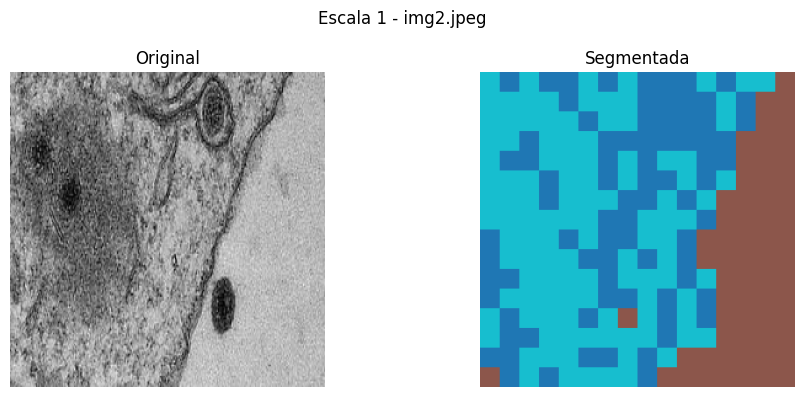

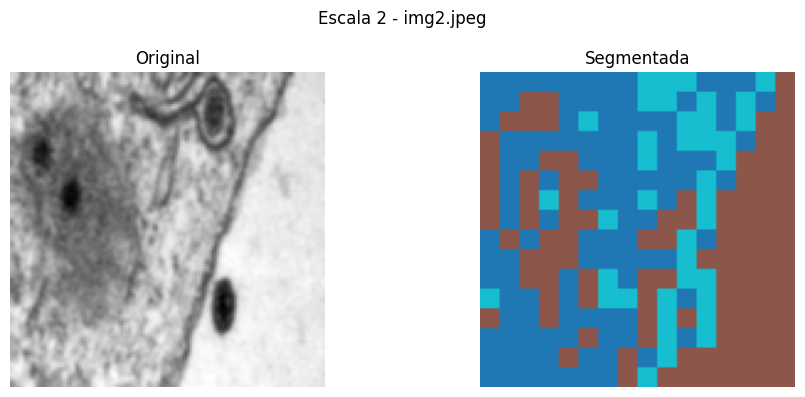

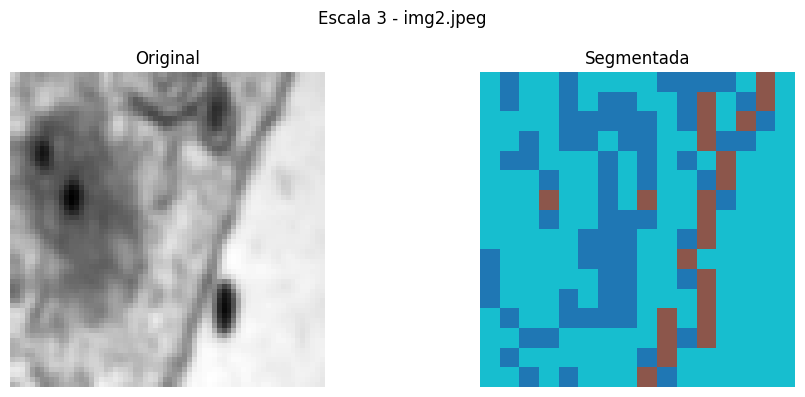

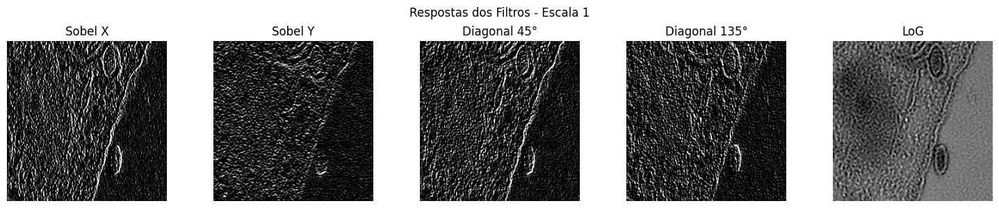

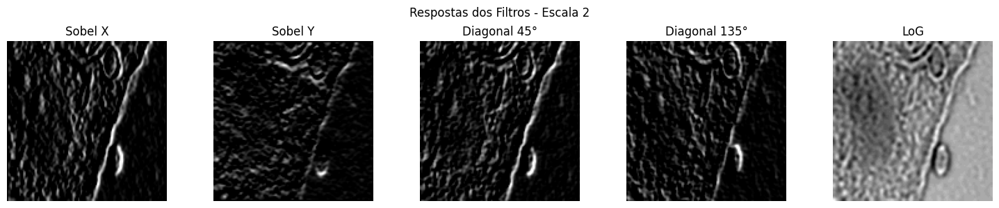

...

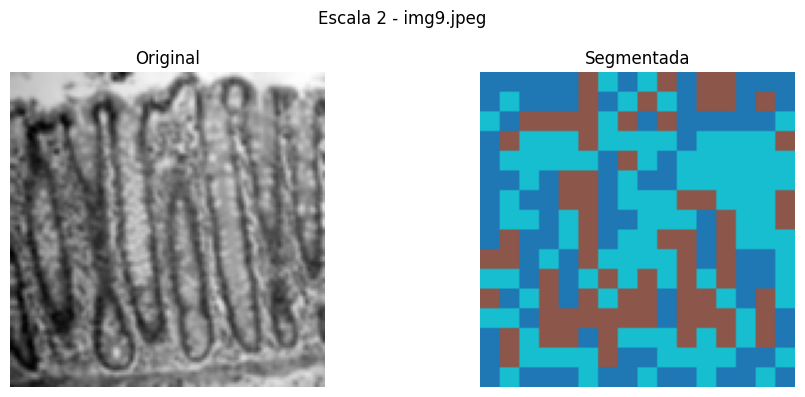

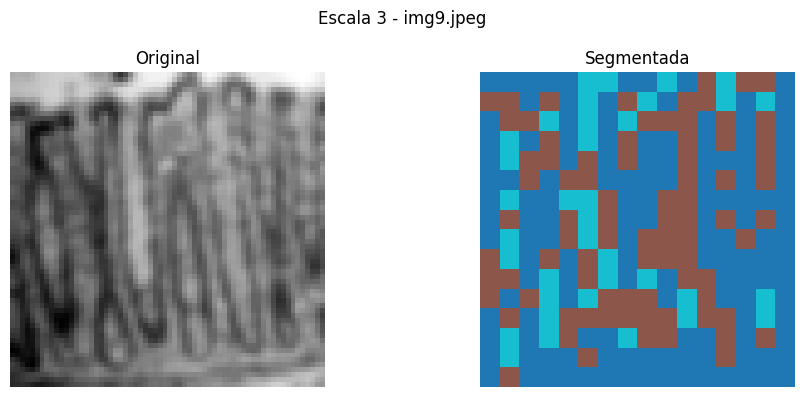

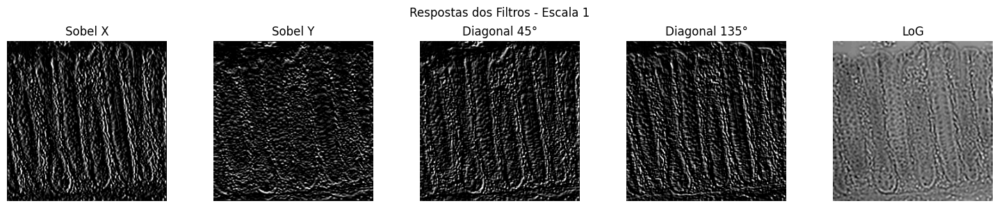

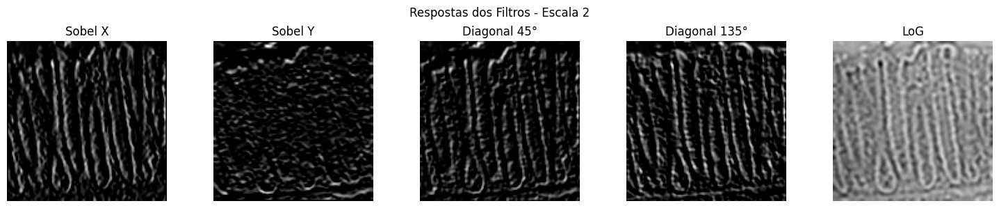

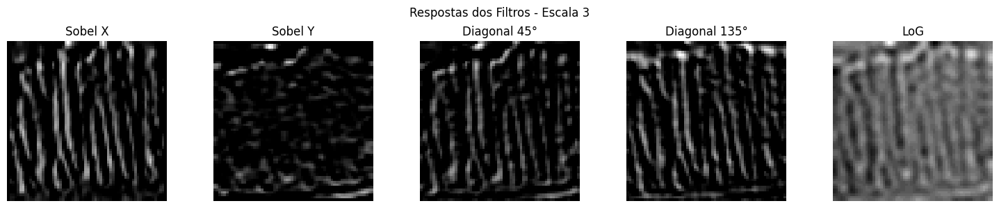

In [ ]:
def main():
    caminhos = carregar_imagens_local("imagens")
    if not caminhos:
        print("Nenhuma imagem encontrada na pasta 'imagens'")
        return

    filtros, nomes_filtros = criar_filtros_textura()
    for caminho in caminhos:
        imagem = carregar_preparar_imagem(caminho)
        if imagem is None:
            continue
        segmentacoes, respostas_filtros, filtros = processar_imagem(imagem, filtros, num_escalas=3, tamanho_janela_base=16, k_clusters=3)
        # realiza os prints das imagens, texturas e segmentacoes
        for i, (seg, original) in enumerate(segmentacoes):
            plt.figure(figsize=(10, 4))
            plt.suptitle(f"Escala {i+1} - {os.path.basename(caminho)}")
            plt.subplot(1, 2, 1)
            plt.imshow(original, cmap="gray")
            plt.title("Original")
            plt.axis("off")
            plt.subplot(1, 2, 2)
            plt.imshow(seg)
            plt.title("Segmentada")
            plt.axis("off")
            plt.tight_layout()
            plt.show()

        for escala, respostas in enumerate(respostas_filtros):
            plt.figure(figsize=(15, 3))
            plt.suptitle(f"Respostas dos Filtros - Escala {escala + 1}")
            for i, resposta in enumerate(respostas):
                plt.subplot(1, len(respostas), i + 1)
                plt.imshow(resposta, cmap='gray')
                plt.title(nomes_filtros[i])
                plt.axis("off")
            plt.tight_layout()
            plt.show()

main()